In [1]:
import pandas as pd
import numpy as np
import folium                                 # Visualização de mapas

from matplotlib import pyplot as plt
from folium.plugins import HeatMap
from folium.plugins import FastMarkerCluster

In [2]:
df_train = pd.read_csv('./sf-crime/train.csv')

In [3]:
df_test = pd.read_csv('./sf-crime/test.csv')

In [4]:
df_train.head()

,Dates,Category,Descript,DayOfWeek,PdDistrict,Resolution,Address,X,Y
0,2015-05-13 23:53:00,WARRANTS,WARRANT ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",OAK ST / LAGUNA ST,-122.425892,37.774599
1,2015-05-13 23:53:00,OTHER OFFENSES,TRAFFIC VIOLATION ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",OAK ST / LAGUNA ST,-122.425892,37.774599
2,2015-05-13 23:33:00,OTHER OFFENSES,TRAFFIC VIOLATION ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",VANNESS AV / GREENWICH ST,-122.424363,37.800414
3,2015-05-13 23:30:00,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Wednesday,NORTHERN,NONE,1500 Block of LOMBARD ST,-122.426995,37.800873
4,2015-05-13 23:30:00,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Wednesday,PARK,NONE,100 Block of BRODERICK ST,-122.438738,37.771541


In [5]:
df_test.head()

,Id,Dates,DayOfWeek,PdDistrict,Address,X,Y
0,0,2015-05-10 23:59:00,Sunday,BAYVIEW,2000 Block of THOMAS AV,-122.399588,37.735051
1,1,2015-05-10 23:51:00,Sunday,BAYVIEW,3RD ST / REVERE AV,-122.391523,37.732432
2,2,2015-05-10 23:50:00,Sunday,NORTHERN,2000 Block of GOUGH ST,-122.426002,37.792212
3,3,2015-05-10 23:45:00,Sunday,INGLESIDE,4700 Block of MISSION ST,-122.437394,37.721412
4,4,2015-05-10 23:45:00,Sunday,INGLESIDE,4700 Block of MISSION ST,-122.437394,37.721412


In [6]:
datetime = df_train['Dates'].str.split()

In [7]:
datetime.dtype

dtype('O')

In [8]:
dates = []
times = []

In [9]:
for date, time in datetime:
    dates.append(date)
    times.append(time)

In [10]:
df_train['date'] = dates
df_train['time'] = times

In [11]:
df_train = df_train.drop('Descript',axis=1)
df_train = df_train.drop('Resolution',axis=1)
df_train = df_train.drop('Dates',axis=1)

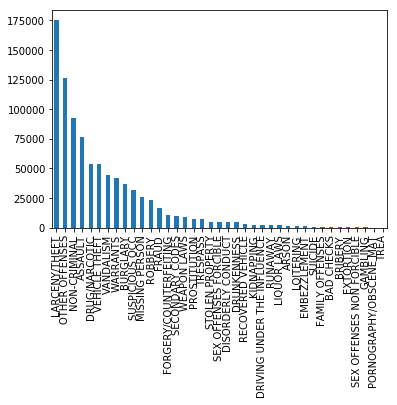

In [12]:
df_train['Category'].value_counts().plot(kind='bar');

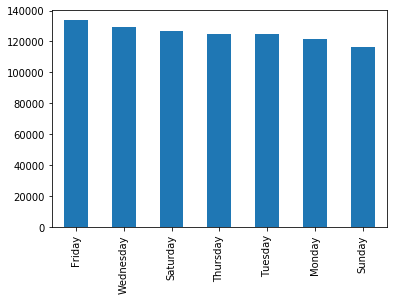

In [13]:
df_train['DayOfWeek'].value_counts().plot(kind='bar');

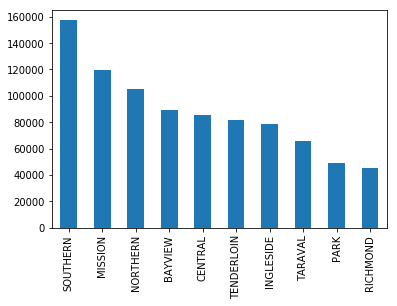

In [14]:
df_train['PdDistrict'].value_counts().plot(kind='bar');

In [ ]:
df_train['Address'].value_counts().plot(kind='bar');

In [15]:
df_train['Category'].unique()

array(['WARRANTS', 'OTHER OFFENSES', 'LARCENY/THEFT', 'VEHICLE THEFT',
       'VANDALISM', 'NON-CRIMINAL', 'ROBBERY', 'ASSAULT', 'WEAPON LAWS',
       'BURGLARY', 'SUSPICIOUS OCC', 'DRUNKENNESS',
       'FORGERY/COUNTERFEITING', 'DRUG/NARCOTIC', 'STOLEN PROPERTY',
       'SECONDARY CODES', 'TRESPASS', 'MISSING PERSON', 'FRAUD',
       'KIDNAPPING', 'RUNAWAY', 'DRIVING UNDER THE INFLUENCE',
       'SEX OFFENSES FORCIBLE', 'PROSTITUTION', 'DISORDERLY CONDUCT',
       'ARSON', 'FAMILY OFFENSES', 'LIQUOR LAWS', 'BRIBERY',
       'EMBEZZLEMENT', 'SUICIDE', 'LOITERING',
       'SEX OFFENSES NON FORCIBLE', 'EXTORTION', 'GAMBLING', 'BAD CHECKS',
       'TREA', 'RECOVERED VEHICLE', 'PORNOGRAPHY/OBSCENE MAT'],
      dtype=object)

In [16]:
df_train.head()

,Category,DayOfWeek,PdDistrict,Address,X,Y,date,time
0,WARRANTS,Wednesday,NORTHERN,OAK ST / LAGUNA ST,-122.425892,37.774599,2015-05-13,23:53:00
1,OTHER OFFENSES,Wednesday,NORTHERN,OAK ST / LAGUNA ST,-122.425892,37.774599,2015-05-13,23:53:00
2,OTHER OFFENSES,Wednesday,NORTHERN,VANNESS AV / GREENWICH ST,-122.424363,37.800414,2015-05-13,23:33:00
3,LARCENY/THEFT,Wednesday,NORTHERN,1500 Block of LOMBARD ST,-122.426995,37.800873,2015-05-13,23:30:00
4,LARCENY/THEFT,Wednesday,PARK,100 Block of BRODERICK ST,-122.438738,37.771541,2015-05-13,23:30:00


In [19]:
df_train = pd.get_dummies(df_train, columns=['DayOfWeek','PdDistrict'],drop_first=True)

In [20]:
df_train.head()

,Category,PdDistrict,Address,X,Y,date,time,DayOfWeek_Monday,DayOfWeek_Saturday,DayOfWeek_Sunday,DayOfWeek_Thursday,DayOfWeek_Tuesday,DayOfWeek_Wednesday
0,WARRANTS,NORTHERN,OAK ST / LAGUNA ST,-122.425892,37.774599,2015-05-13,23:53:00,0,0,0,0,0,1
1,OTHER OFFENSES,NORTHERN,OAK ST / LAGUNA ST,-122.425892,37.774599,2015-05-13,23:53:00,0,0,0,0,0,1
2,OTHER OFFENSES,NORTHERN,VANNESS AV / GREENWICH ST,-122.424363,37.800414,2015-05-13,23:33:00,0,0,0,0,0,1
3,LARCENY/THEFT,NORTHERN,1500 Block of LOMBARD ST,-122.426995,37.800873,2015-05-13,23:30:00,0,0,0,0,0,1
4,LARCENY/THEFT,PARK,100 Block of BRODERICK ST,-122.438738,37.771541,2015-05-13,23:30:00,0,0,0,0,0,1


In [27]:
df = df_train.dropna(subset=['X', 'Y']).copy()
df['coord'] = df[['X','Y']].apply(tuple, axis=1)

m = folium.Map([df['X'].mean(), df['Y'].mean()], zoom_start=10, width='100%', height='100%')
m.add_child(HeatMap(df['coord'], radius=8));

In [28]:
m

In [29]:
X = df_train.drop('Category', axis=1).values
y = df_train['Category'].values

In [30]:
from sklearn.model_selection import train_test_split

In [31]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

In [32]:
from sklearn.preprocessing import StandardScaler

In [33]:
std = StandardScaler()

In [34]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import Perceptron

In [35]:
KNN = KNeighborsClassifier(n_neighbors=3, algorithm='kd_tree', weights='distance')

In [36]:
KNN.fit(X_train,y_train)
y_pred = KNN.predict(X_test)

ValueError: could not convert string to float: 'Sunday'

In [78]:
Perc = Perceptron()

In [79]:
Perc.fit(X_train,y_train)
y_pred2 = Perc.predict(X_test)

/home/michel/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/stochastic_gradient.py:166: FutureWarning: max_iter and tol parameters have been added in Perceptron in 0.19. If both are left unset, they default to max_iter=5 and tol=None. If tol is not None, max_iter defaults to max_iter=1000. From 0.21, default max_iter will be 1000, and default tol will be 1e-3.
  FutureWarning)


ValueError: could not convert string to float: '2013-08-11 15:25:00'